<a href="https://colab.research.google.com/github/PUBPOL-2130/notebooks/blob/main/future/Week9-draft.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [96]:
%config InlineBackend.figure_formats = ["retina"]

In [97]:
!pip install -q osmnx descartes scikit-learn

In [98]:
import geopandas as gpd
import matplotlib.pyplot as plt
import networkx as nx
import osmnx as ox
import pandas as pd
import matplotlib.lines as mlines

from tqdm import tqdm
from descartes import PolygonPatch
from shapely.geometry import Point, LineString, Polygon
from joblib import Parallel, delayed

ox.__version__

'2.0.1'

# Cities and Transit
This week's notebook will be focused on cities and transit. We'll focus on a variety of transit-related datasets from the [NYC](https://data.cityofnewyork.us/browse?sortBy=relevance&pageSize=20&category=Transportation&page=1) Open Data Portal (comparatively, you can also check out the [NY State](https://data.ny.gov/browse?category=Transportation&utf8=%E2%9C%93&sortBy=relevance&page=1&pageSize=20) Open Data Portal). Explore these sites on your own as inspiration for your final projects!

A lot of transportation data can be visualized using networks and flow maps, similar to previous weeks. For example, we can examine [Yellow Taxi Trips](https://data.cityofnewyork.us/Transportation/2023-Yellow-Taxi-Trip-Data/4b4i-vvec/about_data) between pairs of NYC neighborhoods or look at [MTA daily ridership](https://data.ny.gov/Transportation/MTA-Daily-Ridership-Data-2020-2025/vxuj-8kew/about_data) between stations.

However, *measuring distance* is another kind of question that's useful to study in the context of transportation --- relevant to questions like:
* how many subway stations are located within 10 minutes of a park?
* how does voter access to a poll site vary by neighborhood?

While conventional straight-line distance measurements may provide approximate answers to these questions, a better and more realistic approach involves analyzing cities via the *street network*.

In this notebook, we'll discuss open-source approaches to calculating *network distances*, which are distances measured along a network (e.g., a street network). We'll also learn how to make an [isochrone map](https://en.wikipedia.org/wiki/Isochrone_map), which is a type of map that depicts all the area accessible within a given travel time.

In [99]:
subway_stations = gpd.read_file('https://data.ny.gov/resource/39hk-dx4f.geojson?$limit=100000')
subway_stations.head()

,station_id,north_direction_label,line,daytime_routes,complex_id,division,ada_southbound,gtfs_stop_id,structure,ada_notes,stop_name,gtfs_longitude,ada_northbound,ada,south_direction_label,cbd,borough,gtfs_latitude,geometry
0,1,Last Stop,Astoria,N W,1,BMT,0,R01,Elevated,None,Astoria-Ditmars Blvd,-73.912034,0,0,Manhattan,False,Q,40.775036,POINT (-73.91203 40.77504)
1,2,Astoria,Astoria,N W,2,BMT,1,R03,Elevated,None,Astoria Blvd,-73.917843,1,1,Manhattan,False,Q,40.770258,POINT (-73.91784 40.77026)
2,3,Astoria,Astoria,N W,3,BMT,0,R04,Elevated,None,30 Av,-73.921479,0,0,Manhattan,False,Q,40.766779,POINT (-73.92148 40.76678)
3,4,Astoria,Astoria,N W,4,BMT,0,R05,Elevated,None,Broadway,-73.925508,0,0,Manhattan,False,Q,40.76182,POINT (-73.92551 40.76182)
4,5,Astoria,Astoria,N W,5,BMT,0,R06,Elevated,None,36 Av,-73.929575,0,0,Manhattan,False,Q,40.756804,POINT (-73.92958 40.7568)


In [100]:
parks = gpd.read_file('https://nycopendata.socrata.com/resource/enfh-gkve.geojson?$limit=100000')
parks.head()

,jurisdiction,mapped,zipcode,acres,location,nys_assembly,councildistrict,typecategory,us_congress,eapply,...,gisobjid,signname,address,permitparent,class,nys_senate,permitdistrict,borough,waterfront,geometry
0,DPR,True,10034,0.545,Broadway and W. 204 St.,72,10,Historic House Park,13,Dyckman House Museum,...,100003823,Dyckman House Museum,4901 BROADWAY,M-12,PARK,31,M-12,M,0.0,"MULTIPOLYGON (((-73.92305 40.86718, -73.92248 ..."
1,DPR,False,10457,2.213,E 182 St bet. Belmont Av and Croton Av,78,15,Playground,15,Belmont Playground,...,100004948,Belmont Playground,670 EAST 182 STREET,X-06,PARK,32,X-06,X,0.0,"MULTIPOLYGON (((-73.88697 40.85004, -73.88724 ..."
2,DPR,False,10460,0.114,Hornaday Pl bet. Crotona Pkwy and Mohegan Av,87,15,Garden,15,Volky Garden & Flowers,...,100005124,Volky Garden & Flowers,851 HORNADAY PLACE,X-06,PARK,32,X-06,X,0.0,"MULTIPOLYGON (((-73.88234 40.84707, -73.88248 ..."
3,DPR,False,11373,6.219,"Grand Ave., 57 Ave. bet. 74 St. and 80 St.",30,30,Community Park,6,Elmhurst Park,...,100000211,Elmhurst Park,78-01 57 AVENUE,Q-04,PARK,12,Q-04,Q,0.0,"MULTIPOLYGON (((-73.88437 40.72891, -73.8841 4..."
4,DPR,True,10021,3.312,"FDR Dr., E 76 St. To E 78 St.",76,5,Community Park,12,John Jay Park,...,100004745,John Jay Park,76-01 FDR DRIVE,M-08,PARK,28,M-08,M,0.0,"MULTIPOLYGON (((-73.94904 40.76901, -73.94851 ..."


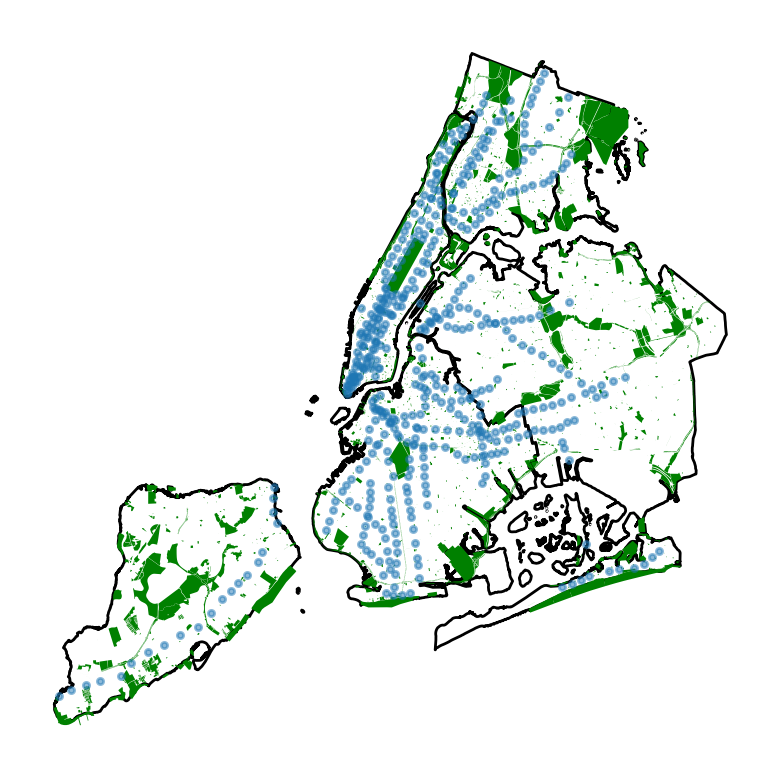

In [101]:
boros = gpd.read_file('https://services5.arcgis.com/GfwWNkhOj9bNBqoJ/arcgis/rest/services/NYC_Borough_Boundary/FeatureServer/0/query?where=1=1&outFields=*&outSR=4326&f=pgeojson')
ax = boros.plot(facecolor='none')
parks.plot(ax=ax, facecolor='green')
subway_stations.plot(ax=ax, alpha=0.5, markersize=5)
ax.set_axis_off();

Let's look at how many subway stations are located within 10 minutes of a park *on average*. 10 minutes walking is roughly a half-mile, so we can equivalently examine the average number of parks within 0.5 miles from a park.

A simple way to do this is to create a [buffer](https://geopandas.org/en/stable/docs/reference/api/geopandas.GeoSeries.buffer.html) in Geopandas, and apply this to the park data. A buffer will return a new geometry containing the original geometry and all the area within a given distance from the original geometry.

First, to specify the correct distance we'll need to make sure that we're in the right projected coordinate system. We'll use [EPSG: 2263](https://spatialreference.org/ref/epsg/2263/), which is a standard projected coordinate system for the NYC area and uses feet as the unit of measurement.

In [102]:
print(parks.crs)
parks_proj = parks.to_crs(2263)
# convert to projected coordinate system!
print(parks_proj.crs)

EPSG:4326
EPSG:2263


In [103]:
# create a buffer of 2640 feet
parks_buffer = parks_proj.copy()
parks_buffer['geometry'] = parks_proj.buffer(2640)

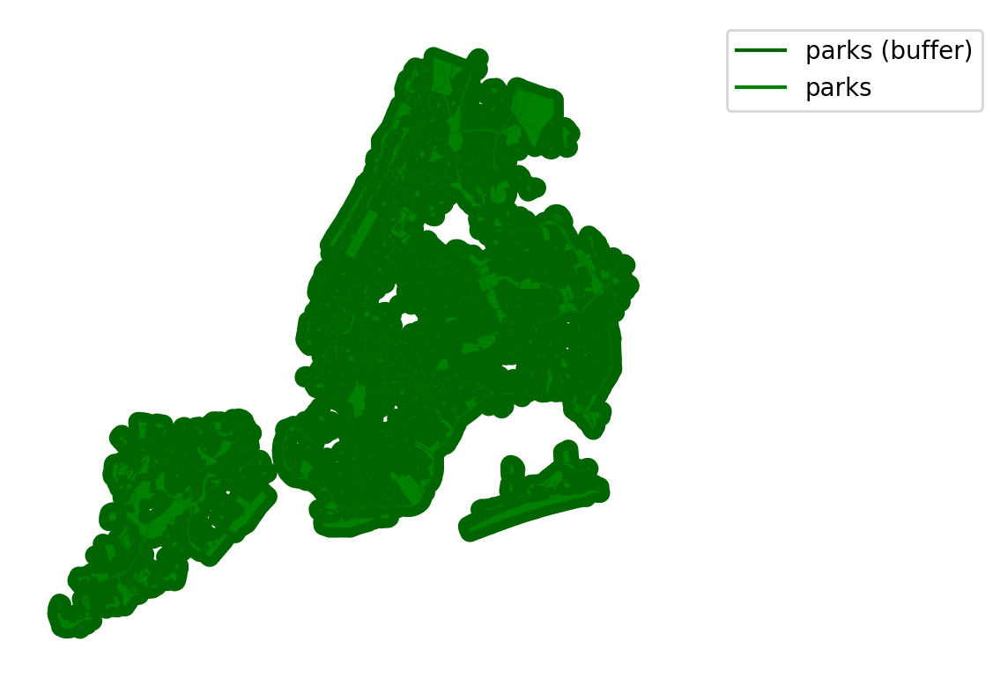

In [104]:
ax = parks_buffer.plot(color='darkgreen')
parks_proj_plot = parks_proj.plot(ax=ax, color='green')

# defining legend style and data
parks_buffer_handle = mlines.Line2D([], [], color='darkgreen', label='parks (buffer)')
parks_handle = mlines.Line2D([], [], color='green', label='parks')

ax.legend(handles=[parks_buffer_handle, parks_handle], loc='upper right', bbox_to_anchor=(1.5, 1))
ax.set_axis_off();

Now, we'll use a [spatial join](https://geopandas.org/en/stable/gallery/spatial_joins.html) to identify the points that intersect the parks buffer. A spatial join works similar to a regular join, but it uses the concept of a spatial intersection or overalp to join the geodataframes rather than an index column.

In [105]:
# check the crs again!
print(subway_stations.crs)
subway_stations = subway_stations.to_crs(2263)
print(subway_stations.crs)

EPSG:4326
EPSG:2263


In [106]:
# dissolve the overlapping polygons
parks_buffer_diss = parks_buffer.dissolve()
# we will use this to see what's not intersecting with our park buffer zone
parks_buffer_diss['10_min_from_park'] = 1

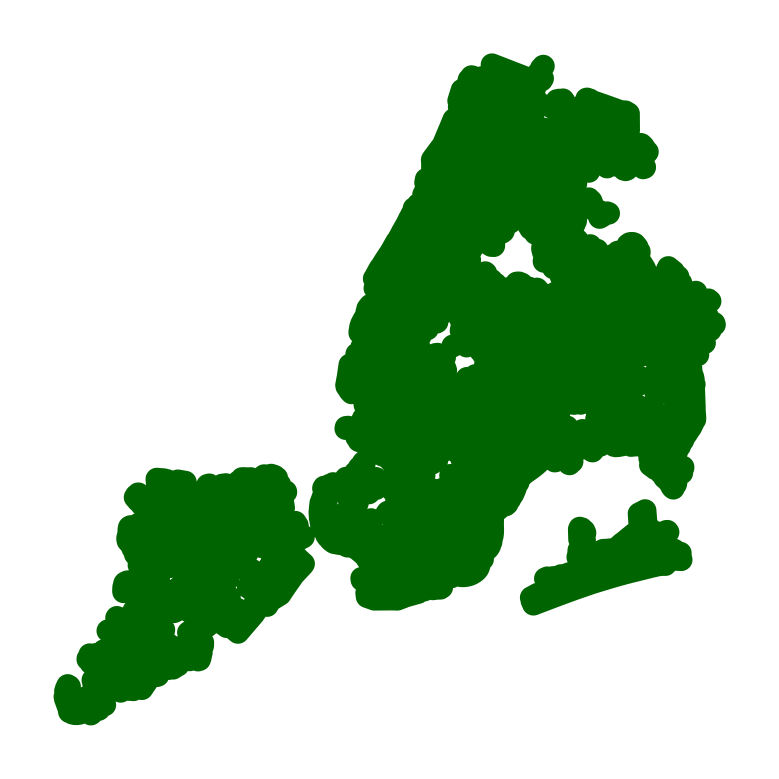

In [107]:
ax = parks_buffer_diss.plot(color='darkgreen')
ax.set_axis_off();

In [108]:
subway_stations_sjoin = subway_stations.sjoin(parks_buffer_diss, how="left")
subway_stations_sjoin.head()

,station_id,north_direction_label,line,daytime_routes,complex_id,division,ada_southbound,gtfs_stop_id,structure,ada_notes,...,gisobjid,signname,address,permitparent,class,nys_senate,permitdistrict,borough_right,waterfront,10_min_from_park
0,1,Last Stop,Astoria,N W,1,BMT,0,R01,Elevated,None,...,100003823,Dyckman House Museum,4901 BROADWAY,M-12,PARK,31,M-12,M,0.0,1.0
1,2,Astoria,Astoria,N W,2,BMT,1,R03,Elevated,None,...,100003823,Dyckman House Museum,4901 BROADWAY,M-12,PARK,31,M-12,M,0.0,1.0
2,3,Astoria,Astoria,N W,3,BMT,0,R04,Elevated,None,...,100003823,Dyckman House Museum,4901 BROADWAY,M-12,PARK,31,M-12,M,0.0,1.0
3,4,Astoria,Astoria,N W,4,BMT,0,R05,Elevated,None,...,100003823,Dyckman House Museum,4901 BROADWAY,M-12,PARK,31,M-12,M,0.0,1.0
4,5,Astoria,Astoria,N W,5,BMT,0,R06,Elevated,None,...,100003823,Dyckman House Museum,4901 BROADWAY,M-12,PARK,31,M-12,M,0.0,1.0


In [109]:
# almost all subway stations are within 10 minutes of a park!
# missing values of our indicator column indicate that it didn't intersect with the park buffer zone
pct_10_min_park = (subway_stations_sjoin['10_min_from_park'].notna().mean()*100)
print(f'{pct_10_min_park.round(2)}% of subway stations are within 10 minutes of a park')

99.8% of subway stations are within 10 minutes of a park


In [110]:
# what is the one subway station that is not within 10 minutes from a park?
subway_stations_sjoin[subway_stations_sjoin['10_min_from_park'].isna()]

,station_id,north_direction_label,line,daytime_routes,complex_id,division,ada_southbound,gtfs_stop_id,structure,ada_notes,...,gisobjid,signname,address,permitparent,class,nys_senate,permitdistrict,borough_right,waterfront,10_min_from_park
195,195,Manhattan,Liberty Av,A,195,IND,1,A65,Elevated,None,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Creating a buffer assumes that straight-line distance is sufficient. But, realistically, straight-line distance is quite a strong assumption.

Now, we'll try calculating the number of subway stations within 10 minutes from a park but we'll calculate distance along a street network.

## Download the street network

We'll download the street network using OSMnx. OSMnx retrieves the place boundaries of the city from the [Nominatim API](https://nominatim.org/), which uses OpenStreetMap data. It retrieves the street networks via the [Overpass API](https://wiki.openstreetmap.org/wiki/Overpass_API) (another API using OpenStreetMap) data. Then, it constructs a graphical model where nodes represent intersections and edges represent streets.

OSMnx leverages [NetworkX](https://networkx.org/documentation/stable/) for constructing graphs, which we've seen in previous notebooks.

It also provides functions for converting between graphs and geodataframes.

In [111]:
# color scheme change
# incorporate biking and driving into network
# from liberty ave. would plot -- would plot an equivalent 30 minutes: walk, drive, bike

In [112]:
# setup, we'll load data for NYC
place = 'New York, NY, USA'
network_type = 'walk'
# try bike, and drive
trip_times = [1, 5, 10] # minutes

In [113]:
# download the street network, this may take a few minutes
G = ox.graph_from_place(place, network_type=network_type)

In [116]:
# project the graph
G = ox.project_graph(G, to_crs=2263)

Let's compute some basic stats about the street network. For example, the number of nodes and the average edge length.

In [117]:
stats = ox.stats.basic_stats(G)
stats

{'n': 273521,
 'm': 898146,
 'k_avg': 6.567290994110142,
 'edge_length_total': 42646336.836194076,
 'edge_length_avg': 47.48263293071959,
 'streets_per_node_avg': 3.2843986384957646,
 'streets_per_node_counts': {0: 0,
  1: 31378,
  2: 3,
  3: 102683,
  4: 138475,
  5: 883,
  6: 90,
  7: 8,
  8: 1},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.11471879672858756,
  2: 1.0968079233404382e-05,
  3: 0.37541175997455406,
  4: 0.5062682572818906,
  5: 0.003228271321032023,
  6: 0.0003290423770021315,
  7: 2.924821128907835e-05,
  8: 3.656026411134794e-06},
 'intersection_count': 242143,
 'street_length_total': 21323168.418097038,
 'street_segment_count': 449073,
 'street_length_avg': 47.48263293071959,
 'circuity_avg': 0.3149964594378306,
 'self_loop_proportion': 0.0013717146210081657}

In [118]:
# store the nodes as a geodataframe
gdf_nodes = ox.graph_to_gdfs(G, edges=False)
gdf_nodes.head()

,y,x,street_count,highway,ref,railway,junction,geometry
osmid,,,,,,,,
30807314,227359.977982,994335.758324,4,NaN,NaN,NaN,NaN,POINT (994335.758 227359.978)
2057103273,226874.729134,994265.458967,4,NaN,NaN,NaN,NaN,POINT (994265.459 226874.729)
6579409036,227473.933093,994488.505785,3,NaN,NaN,NaN,NaN,POINT (994488.506 227473.933)
4303265016,227339.914966,994363.844744,3,NaN,NaN,NaN,NaN,POINT (994363.845 227339.915)
1203806304,227403.098947,994297.112369,4,crossing,NaN,NaN,NaN,POINT (994297.112 227403.099)


In [119]:
# store the edges as a geodataframe
gdf_edges = ox.graph_to_gdfs(G, nodes=False, edges=True).reset_index()
gdf_edges.head()

,u,v,key,osmid,highway,oneway,reversed,length,geometry,name,...,ref,access,junction,service,bridge,width,tunnel,est_width,area,landuse
0,30807314,2057103273,0,46613689,bridleway,False,False,159.255042,"LINESTRING (994335.758 227359.978, 994328.783 ...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,30807314,6579409036,0,46613689,bridleway,False,True,58.144181,"LINESTRING (994335.758 227359.978, 994344.672 ...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,30807314,4303265016,0,147089927,footway,False,False,10.509449,"LINESTRING (994335.758 227359.978, 994349.829 ...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,30807314,1203806304,0,147089927,footway,False,True,17.645411,"LINESTRING (994335.758 227359.978, 994307.584 ...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2057103273,1203806190,0,1081028185,footway,False,True,15.480750,"LINESTRING (994265.459 226874.729, 994315.639 ...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [120]:
# get the nearest street nodes from the park centroids
park_nodes = ox.nearest_nodes(G, parks_proj.centroid.x, parks_proj.centroid.y)


Another way you could do this is to grab any street that intersects within a 100-foot buffer around the parks:

In [121]:
parks_proj_buffer = parks_proj.copy()
parks_proj_buffer['geometry'] = parks_proj_buffer['geometry'].buffer(100)
gdf_edges_park = gdf_edges.sjoin(parks_proj_buffer)
gdf_edges_park.head()

,u,v,key,osmid,highway,oneway,reversed,length,geometry,name,...,omppropid,gisobjid,signname,address,permitparent,class,nys_senate,permitdistrict,borough,waterfront
0,30807314,2057103273,0,46613689,bridleway,False,False,159.255042,"LINESTRING (994335.758 227359.978, 994328.783 ...",NaN,...,M010,100004894,Central Park,1000 5 AVENUE,M-13,PARK,283047,M-13,M,0.0
1,30807314,6579409036,0,46613689,bridleway,False,True,58.144181,"LINESTRING (994335.758 227359.978, 994344.672 ...",NaN,...,M010,100004894,Central Park,1000 5 AVENUE,M-13,PARK,283047,M-13,M,0.0
2,30807314,4303265016,0,147089927,footway,False,False,10.509449,"LINESTRING (994335.758 227359.978, 994349.829 ...",NaN,...,M010,100004894,Central Park,1000 5 AVENUE,M-13,PARK,283047,M-13,M,0.0
3,30807314,1203806304,0,147089927,footway,False,True,17.645411,"LINESTRING (994335.758 227359.978, 994307.584 ...",NaN,...,M010,100004894,Central Park,1000 5 AVENUE,M-13,PARK,283047,M-13,M,0.0
4,2057103273,1203806190,0,1081028185,footway,False,True,15.480750,"LINESTRING (994265.459 226874.729, 994315.639 ...",NaN,...,M010,100004894,Central Park,1000 5 AVENUE,M-13,PARK,283047,M-13,M,0.0


In [122]:
gdf_edges_park.shape

(203594, 56)

In [123]:
# another thing you could do here, grab a street within the bufferrtol -- 
# look at small buffer around park, look at overlapping street corners

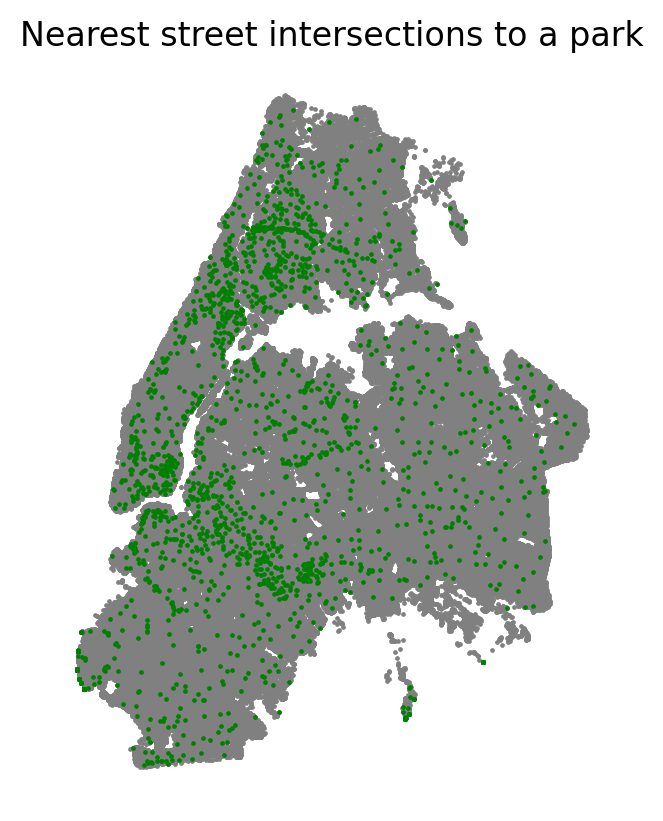

In [124]:
ax = gdf_nodes.plot(color='gray', markersize=0.5)
gdf_nodes.loc[park_nodes].plot(ax=ax, color='green', markersize=0.5)
ax.set_title('Nearest street intersections to a park')
ax.set_axis_off();

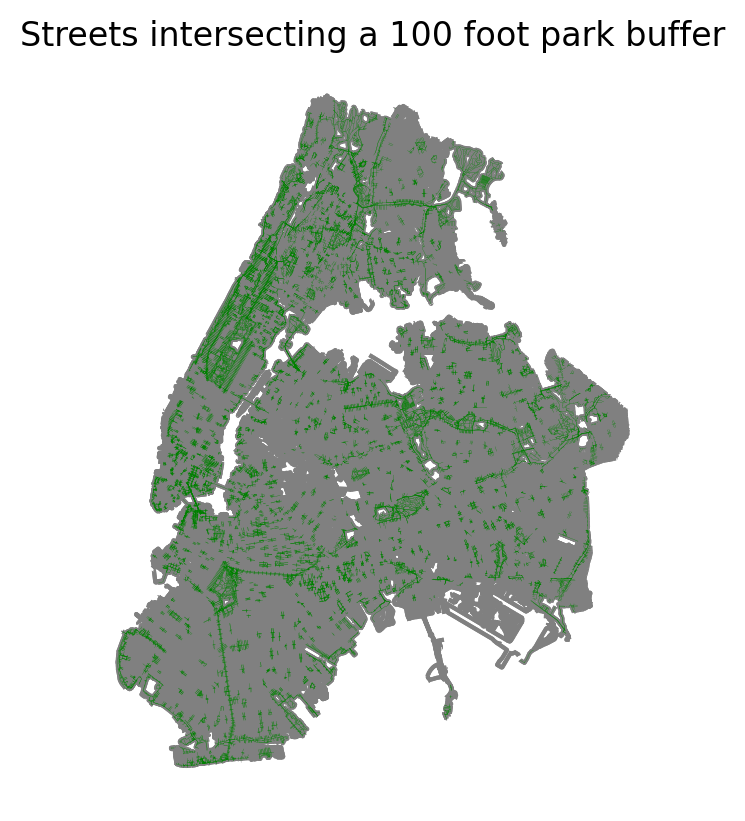

In [125]:
ax = gdf_edges.plot(color='gray', markersize=0.5)
gdf_edges_park.plot(ax=ax, color='green', linewidth=0.05)
ax.set_title('Streets intersecting a 100 foot park buffer')
ax.set_axis_off();

Now, we'll add edge information that estimates the amount of time required to traverse each edge.

In [126]:
avg_feet_per_second = 4.6 # you can change this!

for u, v, k, data in G.edges(data=True, keys=True):
    data['length'] = data['length']*3.28084 # osmnx internal units are meters
    data['time'] = data['length'] / (avg_feet_per_second * 60) # divide by feet per minute

## How far can you walk on foot within each time?

In [127]:
# define colors for each isochrone
iso_colors = ['darkgreen', 'green', 'lightgreen']
iso_colors

# color the nodes according to isochrone then plot the street network
node_colors = {}
for park_node in tqdm(park_nodes):
    for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
        subgraph = nx.ego_graph(G, park_node, radius=trip_time, distance='time')
        for node in subgraph.nodes():
            node_colors[node] = color
node_colors

100%|██████████| 2052/2052 [00:24<00:00, 82.84it/s] 


{9561395217: 'green',
 9561395219: 'green',
 9561395221: 'green',
 9561395222: 'green',
 5071822871: 'green',
 9561395242: 'lightgreen',
 9561395246: 'lightgreen',
 9561395247: 'lightgreen',
 9561395248: 'green',
 9561395252: 'lightgreen',
 1205714997: 'green',
 9561395258: 'lightgreen',
 9561395259: 'lightgreen',
 9561395262: 'green',
 9561395263: 'green',
 9561395264: 'green',
 9561395265: 'lightgreen',
 9561395266: 'lightgreen',
 9561395268: 'lightgreen',
 9561395269: 'lightgreen',
 12001052740: 'darkgreen',
 9561395271: 'green',
 12001052746: 'darkgreen',
 9561395275: 'green',
 3805630539: 'green',
 9561395277: 'green',
 9561395278: 'green',
 9561395279: 'green',
 9561395280: 'green',
 9561395281: 'green',
 11596111951: 'darkgreen',
 9561395283: 'green',
 9561395284: 'green',
 9561395285: 'green',
 11596111952: 'darkgreen',
 5608300628: 'darkgreen',
 11596111953: 'darkgreen',
 5608300631: 'darkgreen',
 5608300633: 'darkgreen',
 11596111960: 'darkgreen',
 11596111961: 'darkgreen',
 

Now, we'll plot the street *nodes* that are within 1, 5 and 10 minutes of a park

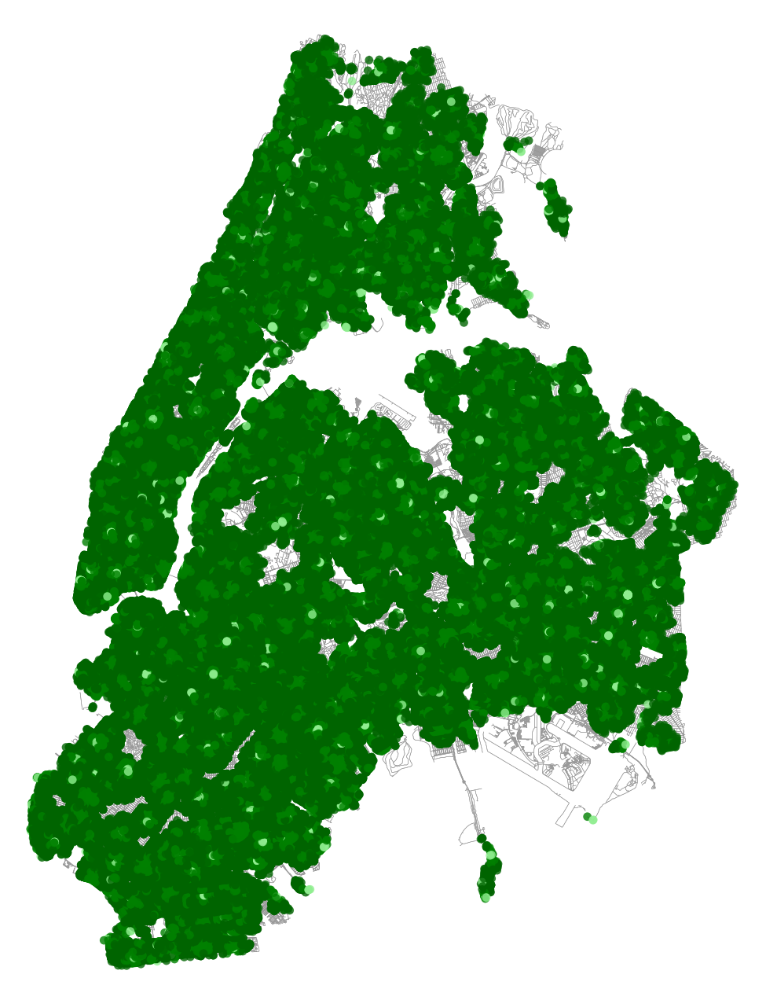

In [128]:
nc = [node_colors[node] if node in node_colors else 'none' for node in G.nodes()]
ns = [15 if node in node_colors else 0 for node in G.nodes()]
fig, ax = ox.plot_graph(G, node_color=nc, node_size=ns, node_alpha=0.8, node_zorder=2,
                        bgcolor='w', edge_linewidth=0.2, edge_color='#999999')

## Produce Isochrones

* Approach 1: Use convex hull
* Approach 2: Create a buffer along street edges

Several functions below make use of code originally provided in this [example notebook](https://github.com/gboeing/osmnx-examples/blob/main/notebooks/13-isolines-isochrones.ipynb) on using OSMnx to produce isochrones. The functions have been modified and simplified here to focus on the specific content (i.e., parks and subways).

In [129]:
# do side by side: pick a location, could be that one subway station -- liberty ave?
# the 30 minute equivalent in crow-flies vs. 30 minute network thing
# do different color scheme -- crow-flies in 2 greens, equivalent in network distance light blue vs. dark blues

In [130]:
selected_subway_station = subway_stations_sjoin[subway_stations_sjoin['station_id']=='195']
selected_subway_station

,station_id,north_direction_label,line,daytime_routes,complex_id,division,ada_southbound,gtfs_stop_id,structure,ada_notes,...,gisobjid,signname,address,permitparent,class,nys_senate,permitdistrict,borough_right,waterfront,10_min_from_park
195,195,Manhattan,Liberty Av,A,195,IND,1,A65,Elevated,None,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [131]:
# identify the closest node on the street network
closest_node = ox.nearest_nodes(G, selected_subway_station.geometry.x, selected_subway_station.geometry.y)
closest_node

array([42927754])

In [132]:
# make the isochrone polygons, using convex hull
isochrone_polys = {x:[] for x in trip_times}
for park_node in tqdm(closest_node): # note: this loop can also take in a list of nodes
    for trip_time in sorted(trip_times, reverse=True):
        subgraph = nx.ego_graph(G, park_node, radius=trip_time, distance='time')
        node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
        bounding_poly = gpd.GeoSeries(node_points).union_all().convex_hull
        isochrone_polys[trip_time].append(bounding_poly)
isochrone_polys;

100%|██████████| 1/1 [00:00<00:00, 43.65it/s]


In [133]:
# create dataframe of convex hulls
isochrone_gdf_list = []
for trip_time in trip_times:
    isochrone_gdf_list += [gpd.GeoDataFrame(geometry=isochrone_polys[trip_time], crs=2263).assign(trip_time=trip_time)]
isochrone_gpd = pd.concat(isochrone_gdf_list)

In [134]:
# for plotting, create a subgraph just of queens
queens_nodes = gdf_nodes.sjoin(boros[boros['BoroName']=='Queens'].to_crs(2263)).index
G_queens = G.subgraph(ints_nodes)
G_queens;

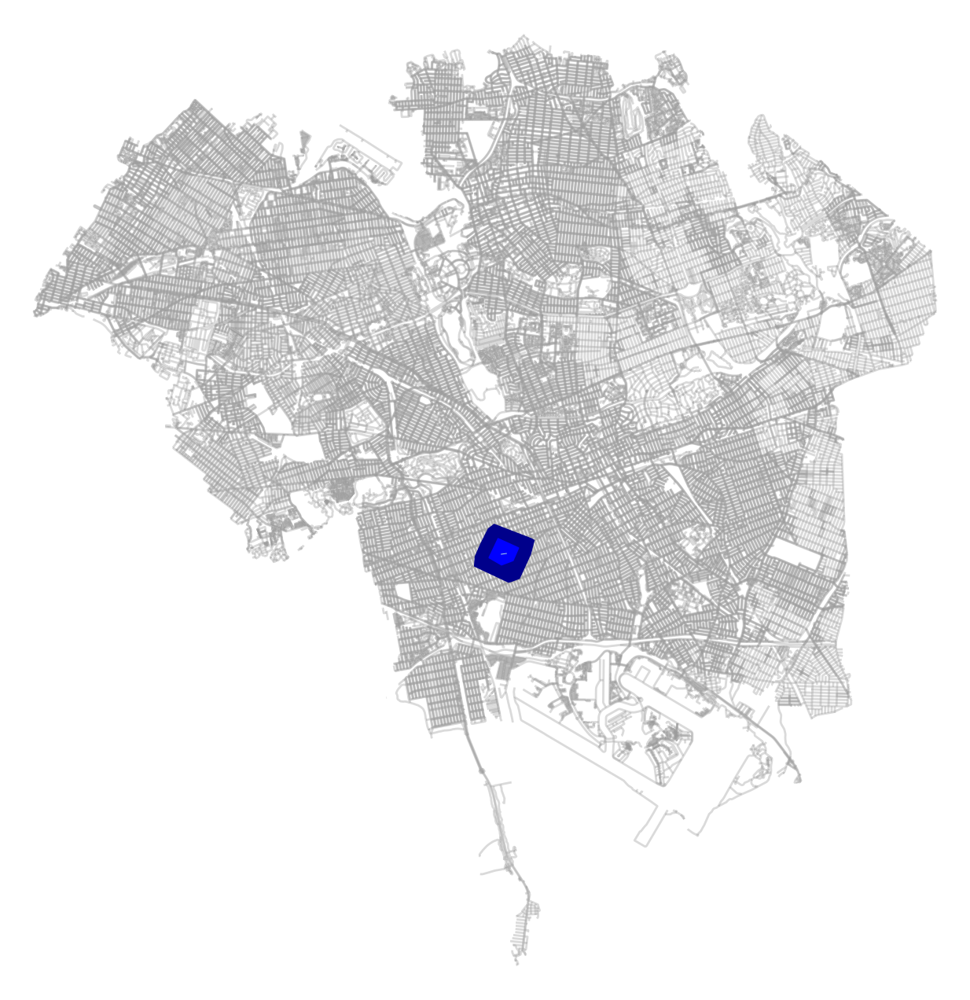

In [142]:
iso_colors = ['darkblue', 'blue', 'lightblue']
# plot the network then add isochrones
fig, ax = ox.plot_graph(G_queens, show=False, close=False, edge_color='#999999', edge_alpha=0.2,
                        node_size=0, bgcolor='w')
for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
    isochrone_gpd[isochrone_gpd['trip_time']==trip_time].plot(ax=ax, color=color)
ax.set_axis_off()
plt.show()

## Plot isochrones as buffers

In [139]:
def create_edge_lines(G, nodes_gdf, n_fr, n_to):
    f = nodes_gdf.loc[n_fr].geometry
    t = nodes_gdf.loc[n_to].geometry
    return G.get_edge_data(n_fr, n_to)[0].get('geometry',  LineString([f,t]))

def make_iso_polys(node_list, G, edge_buff=25, node_buff=50, infill=False):
    isochrone_polys = {x:[] for x in trip_times}
    for nd in tqdm(node_list):
        for trip_time in sorted(trip_times, reverse=True):
            subgraph = nx.ego_graph(G, nd, radius=trip_time, distance='time')
            node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
            nodes_gdf = gpd.GeoDataFrame({'id': subgraph.nodes()}, geometry=node_points)
            nodes_gdf = nodes_gdf.set_index('id')

            edge_lines = []
            for n_fr, n_to in subgraph.edges():
                edge_lookup = create_edge_lines(G, nodes_gdf, n_fr, n_to)
                edge_lines.append(edge_lookup)
                

            n = nodes_gdf.buffer(node_buff).geometry
            e = gpd.GeoSeries(edge_lines).buffer(edge_buff).geometry
            all_gs = list(n) + list(e)
            new_iso = gpd.GeoSeries(all_gs).union_all()
            isochrone_polys[trip_time].append(new_iso)
    return isochrone_polys
#res = Parallel(n_jobs=4)(delayed(make_iso_polys)(nd, G) for nd in park_nodes[:10])
isochrone_polys = make_iso_polys(closest_node, G, edge_buff=25, node_buff=0, infill=True)

  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 1/1 [00:00<00:00,  1.73it/s]


In [140]:
# create dataframe of buffer regions
isochrone_buffer_gdf_list = []
for trip_time in [5, 10]:
    isochrone_buffer_gdf_list += [gpd.GeoDataFrame(geometry=isochrone_polys[trip_time], crs=2263).assign(trip_time=trip_time)]
isochrone_buffer_gpd = pd.concat(isochrone_buffer_gdf_list)

/var/folders/_q/g5l2s5950hz1zr9syt43gzp80000gn/T/ipykernel_25502/3142910634.py:5: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  isochrone_buffer_gpd[isochrone_buffer_gpd['trip_time']==trip_time].plot(ax=ax, color=color)


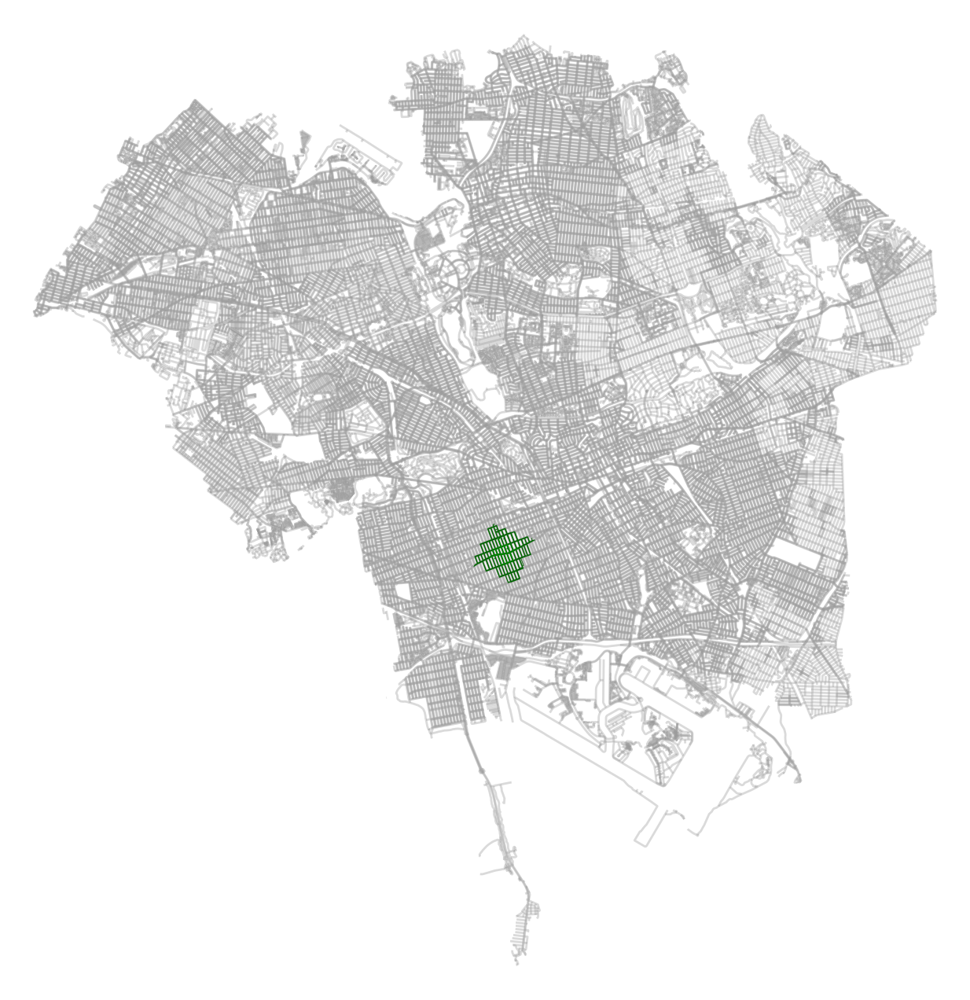

In [141]:
# plot the network then add isochrones as colored descartes polygon patches
fig, ax = ox.plot_graph(G_queens, show=False, close=False, edge_color='#999999', edge_alpha=0.2,
                        node_size=0, bgcolor='w')
for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors):
    isochrone_buffer_gpd[isochrone_buffer_gpd['trip_time']==trip_time].plot(ax=ax, color=color)
ax.set_axis_off()
plt.show()

## Now let's compare to biking and driving!

In [193]:
# download the bike network, this may take a few minutes
G_bike = ox.graph_from_place(place, network_type='bike')

# download the driving network, this may take a few minutes
G_drive = ox.graph_from_place(place, network_type='drive')

In [244]:
G_bike = ox.project_graph(G_bike, to_crs=2263)
G_drive = ox.project_graph(G_drive, to_crs=2263)

In [249]:
mode_types = ['walk', 'bike', 'drive']
graph_list = [G, G_bike, G_drive]

avg_feet_per_min = {
    'walk': 352,
    'bike': 880,
    'drive': 2640
}

for mode_type, graph in zip(mode_types, graph_list):
    for u, v, k, data in graph.edges(data=True, keys=True):
        #data['length'] = data['length']*3.28084 # osmnx internal units are meters
        data['time'] = data['length'] / (avg_feet_per_min[mode_type]) # divide by feet per minute
        if mode_type == 'drive':
            print(data)

{'osmid': 25161349, 'highway': 'motorway', 'lanes': '2', 'maxspeed': '50 mph', 'name': 'Cross Island Parkway', 'oneway': True, 'ref': 'CI', 'reversed': False, 'length': 8821.043085305795, 'geometry': <LINESTRING (1041088.611 225830.47, 1041125.514 225846.842, 1041161.31 22586...>, 'time': 3.3413041989794676}
{'osmid': 25161578, 'highway': 'motorway_link', 'oneway': True, 'reversed': False, 'length': 2886.2792047192615, 'geometry': <LINESTRING (1041088.611 225830.47, 1041484.92 225992.912, 1041519.279 22600...>, 'time': 1.093287577545175}
{'osmid': [39084897, 40944009, 40944010], 'highway': 'motorway', 'lanes': '3', 'maxspeed': '50 mph', 'name': 'Cross Island Parkway', 'oneway': True, 'ref': 'CI', 'reversed': False, 'length': 6851.724852997735, 'geometry': <LINESTRING (1043518.695 226940.516, 1043557.92 226945.931, 1043595.596 2269...>, 'time': 2.595350323105203, 'bridge': 'yes'}
{'osmid': 25161438, 'highway': 'tertiary', 'name': 'Cross Island Parkway Service Road', 'oneway': False, 're

In [253]:
# make the isochrone polygons for bike and driving
isochrone_polys_by_mode = {mode_type: {x:[] for x in trip_times} for mode_type in mode_types}
for mode_type, graph in zip(mode_types, graph_list):
    for node in tqdm(closest_node): # note: this loop can also take in a list of nodes
        for trip_time in sorted(trip_times, reverse=True):
            subgraph = nx.ego_graph(graph, node, radius=trip_time, distance='time')
            node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
            bounding_poly = gpd.GeoSeries(node_points).union_all().convex_hull
            isochrone_polys_by_mode[mode_type][trip_time].append(bounding_poly)
isochrone_polys_by_mode;

  0%|          | 0/1 [00:00<?, ?it/s]

MultiDiGraph with 273521 nodes and 898146 edges
MultiDiGraph with 273521 nodes and 898146 edges


100%|██████████| 1/1 [00:00<00:00,  1.48it/s]


MultiDiGraph with 273521 nodes and 898146 edges


  0%|          | 0/1 [00:00<?, ?it/s]

MultiDiGraph with 82817 nodes and 201587 edges
MultiDiGraph with 82817 nodes and 201587 edges


100%|██████████| 1/1 [00:00<00:00,  4.51it/s]


MultiDiGraph with 82817 nodes and 201587 edges


  0%|          | 0/1 [00:00<?, ?it/s]

MultiDiGraph with 55238 nodes and 139293 edges


100%|██████████| 1/1 [00:00<00:00,  6.49it/s]

MultiDiGraph with 55238 nodes and 139293 edges
MultiDiGraph with 55238 nodes and 139293 edges


In [256]:
isochrone_gdf_mode = pd.concat([pd.DataFrame.from_dict(isochrone_polys_by_mode[mode_type], orient='index').assign(mode_type=mode_type) for mode_type in mode_types]).reset_index().rename(columns={'index':'time'})
isochrone_gdf_mode = isochrone_gdf_mode.set_geometry(0, crs=2263)
isochrone_gdf_mode

,time,0,mode_type
0,1,POINT (1032527.948 189227.666),walk
1,5,POINT (1032527.948 189227.666),walk
2,10,POINT (1032527.948 189227.666),walk
3,1,"POLYGON ((1032275.806 189191.862, 1032769.579 ...",bike
4,5,"POLYGON ((1032570.83 188402.689, 1031323.7 188...",bike
5,10,"POLYGON ((1033102.027 186987.966, 1032182.641 ...",bike
6,1,"POLYGON ((1031780.192 189123.995, 1032311.26 1...",drive
7,5,"POLYGON ((1033645.841 185823.649, 1033390.819 ...",drive
8,10,"POLYGON ((1032747.245 182016.051, 1032481.695 ...",drive


In [257]:
iso_colors_dict = {
    'walk': ['darkgreen', 'green', 'lightgreen'],
    'bike': ['darkblue', 'blue', 'lightblue'],
    'drive': ['darkred', 'red', 'orange']
}

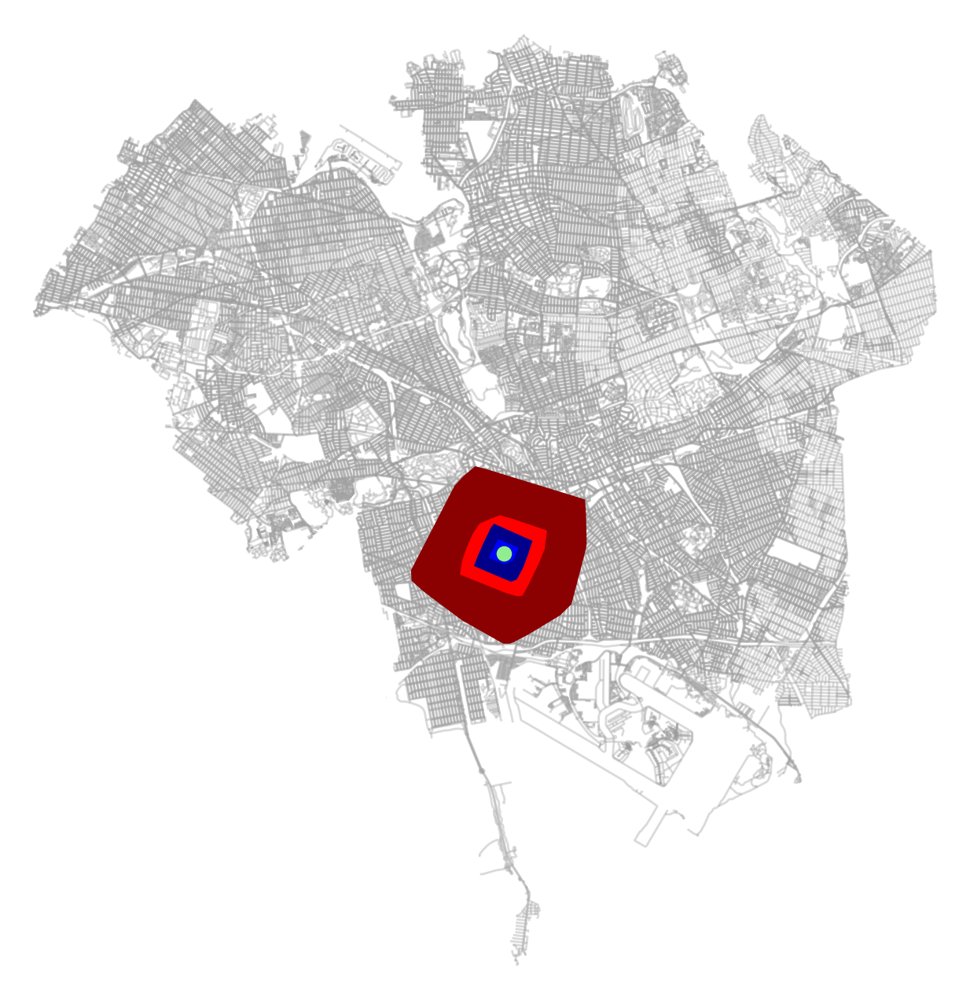

In [258]:
# plot the network then add isochrones as colored descartes polygon patches
fig, ax = ox.plot_graph(G_queens, show=False, close=False, edge_color='#999999', edge_alpha=0.2,
                        node_size=0, bgcolor='w')
for mode_type in ['drive', 'bike', 'walk']:
    for trip_time, color in zip(sorted(trip_times, reverse=True), iso_colors_dict[mode_type]):
        isochrone_gdf_subset = isochrone_gdf_mode[(isochrone_gdf_mode['mode_type']==mode_type)\
            &(isochrone_gdf_mode['time']==trip_time)]
        isochrone_gdf_subset.plot(ax=ax, color=color)
ax.set_axis_off()
plt.show()